In [6]:
# Import necessary libraries
import os
import tensorflow as tf
import tensorflow_hub as hub
import matplotlib.pyplot as plt
import numpy as np
import PIL.Image
import time
from tensorflow.keras.layers import Layer

In [7]:
# Configure environment
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'
plt.rcParams['figure.figsize'] = (12, 12)
plt.rcParams['axes.grid'] = False

In [8]:
# Helper functions
def tensor_to_image(tensor):
    tensor = tensor * 255
    tensor = np.array(tensor, dtype=np.uint8)
    if np.ndim(tensor) > 3:
        assert tensor.shape[0] == 1
        tensor = tensor[0]
    return PIL.Image.fromarray(tensor)

In [9]:
def load_img(path_to_img):
    max_dim = 512
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim
    new_shape = tf.cast(shape * scale, tf.int32)
    img = tf.image.resize(img, new_shape)
    img = img[tf.newaxis, :]  # Add batch dimension
    return img

In [10]:
def imshow(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)
    plt.imshow(image)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

In [11]:
# Define spatial attention layer
class SpatialAttention(Layer):
    def __init__(self):
        super(SpatialAttention, self).__init__()

    def call(self, inputs):
        avg_pool = tf.reduce_mean(inputs, axis=-1, keepdims=True)
        max_pool = tf.reduce_max(inputs, axis=-1, keepdims=True)
        concat = tf.concat([avg_pool, max_pool], axis=-1)
        attention = tf.sigmoid(concat)
        return inputs * attention

In [14]:
class SpatialAttention(Layer):
    def __init__(self):
        super(SpatialAttention, self).__init__()

    def call(self, inputs):
        # Compute average and max pooling along the channel dimension
        avg_pool = tf.reduce_mean(inputs, axis=-1, keepdims=True)  # Shape: (batch_size, height, width, 1)
        max_pool = tf.reduce_max(inputs, axis=-1, keepdims=True)  # Shape: (batch_size, height, width, 1)

        # Concatenate along the channel axis
        concat = tf.concat([avg_pool, max_pool], axis=-1)  # Shape: (batch_size, height, width, 2)

        # Apply convolution to learn the attention map
        attention = tf.keras.layers.Conv2D(1, kernel_size=1, padding='same', activation='sigmoid')(concat)  # Shape: (batch_size, height, width, 1)

        # Multiply the input by the attention map
        return inputs * attention  # Shape: (batch_size, height, width, channels)


In [15]:
# Define GAN components
def build_generator():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(512, 512, 3)))
    model.add(tf.keras.layers.Conv2D(64, kernel_size=3, padding='same', activation='relu'))
    model.add(SpatialAttention())
    model.add(tf.keras.layers.Conv2D(3, kernel_size=3, padding='same', activation='sigmoid'))
    return model

def build_discriminator():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(512, 512, 3)))
    model.add(tf.keras.layers.Conv2D(64, kernel_size=3, strides=2, padding='same', activation='relu'))
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1, activation='sigmoid'))
    return model

In [16]:
# Initialize GAN
generator = build_generator()
discriminator = build_discriminator()

In [17]:
# Compile models
generator.compile(optimizer='adam', loss='binary_crossentropy')
discriminator.compile(optimizer='adam', loss='binary_crossentropy')

In [18]:
# Load images
content_path = "1.png"
style_path = "2.png"
content_image = load_img(content_path)
style_image = load_img(style_path)

In [19]:
# Load VGG19 model
def vgg_layers(layer_names):
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False
    outputs = [vgg.get_layer(name).output for name in layer_names]
    model = tf.keras.Model([vgg.input], outputs)
    return model

In [20]:
# Define style and content layers
content_layers = ['block5_conv2']
style_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

In [21]:
# Define StyleContentModel class
class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleContentModel, self).__init__()
        self.vgg = vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        inputs = inputs * 255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs, content_outputs = (outputs[:self.num_style_layers], outputs[self.num_style_layers:])
        style_outputs = [gram_matrix(style_output) for style_output in style_outputs]
        content_dict = {content_name: value for content_name, value in zip(self.content_layers, content_outputs)}
        style_dict = {style_name: value for style_name, value in zip(self.style_layers, style_outputs)}
        return {'content': content_dict, 'style': style_dict}

In [22]:
# Gram matrix function
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1] * input_shape[2], tf.float32)
    return result / num_locations

In [23]:
# Initialize StyleContentModel
extractor = StyleContentModel(style_layers, content_layers)
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

In [24]:
# Initialize the image to optimize
image = tf.Variable(content_image)

In [25]:
# Optimizer
opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

In [26]:
# Loss weights
style_weight = 1e-2
content_weight = 1e4
total_variation_weight = 30

In [27]:
# Define loss functions
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name] - style_targets[name])**2) for name in style_outputs.keys()])
    style_loss *= style_weight / len(style_layers)
    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name] - content_targets[name])**2) for name in content_outputs.keys()])
    content_loss *= content_weight / len(content_layers)
    loss = style_loss + content_loss
    return loss

def total_variation_loss(image):
    x_deltas, y_deltas = high_pass_x_y(image)
    return tf.reduce_sum(tf.abs(x_deltas)) + tf.reduce_sum(tf.abs(y_deltas))

def high_pass_x_y(image):
    x_var = image[:, :, 1:, :] - image[:, :, :-1, :]
    y_var = image[:, 1:, :, :] - image[:, :-1, :, :]
    return x_var, y_var

@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs)
        loss += total_variation_weight * tf.image.total_variation(image)
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

@tf.function()
def gan_train_step(image, stylized_image):
    with tf.GradientTape() as tape:
        generated_image = generator(image)
        disc_real = discriminator(stylized_image)
        disc_fake = discriminator(generated_image)

        gan_loss = -tf.reduce_mean(tf.math.log(disc_fake + 1e-10))  # Minimize loss on fake
        grad = tape.gradient(gan_loss, generator.trainable_variables)
        generator.optimizer.apply_gradients(zip(grad, generator.trainable_variables))

In [ ]:
# Run the optimization
epochs = 10
steps_per_epoch = 100

start = time.time()

for n in range(epochs):
    for m in range(steps_per_epoch):
        train_step(image)
        gan_train_step(content_image, tensor_to_image(image))
        print(".", end='', flush=True)
    plt.imshow(tensor_to_image(image))
    plt.title(f"Epoch {n + 1}")
    plt.axis('off')
    plt.show()

end = time.time()
print(f"Total time: {end - start:.1f} seconds")

In [ ]:
# Save the result
file_name = 'stylized-image.png'
tensor_to_image(image).save(file_name)

# Edge sketch generation
def edge_sketch(image):
    image = tensor_to_image(image).convert('L')  # Convert to grayscale
    edges = image.filter(PIL.ImageFilter.FIND_EDGES)
    return edges

# Generate edge sketches for content and stylized images
content_edges = edge_sketch(content_image)
stylized_edges = edge_sketch(image)

# Saliency map generation
def saliency_map(image):
    image = tf.image.resize(image, (224, 224))  # Resize for VGG19
    image = tf.expand_dims(image, axis=0)
    with tf.GradientTape() as tape:
        tape.watch(image)
        preds = extractor(image)
    grads = tape.gradient(preds, image)
    saliency = tf.reduce_max(tf.abs(grads), axis=-1)
    return saliency[0]

# Generate saliency maps
content_saliency = saliency_map(content_image)
stylized_saliency = saliency_map(image)

# Display results
plt.figure(figsize=(12, 12))
plt.subplot(2, 2, 1)
imshow(content_edges, 'Content Image Edge Sketch')
plt.subplot(2, 2, 2)
imshow(stylized_edges, 'Stylized Image Edge Sketch')
plt.subplot(2, 2, 3)
imshow(content_saliency, 'Content Saliency Map')
plt.subplot(2, 2, 4)
imshow(stylized_saliency, 'Stylized Saliency Map')
plt.show()

# Optionally download the image if running in Google Colab
try:
    from google.colab import files
    files.download(file_name)
except (ImportError, AttributeError):
    pass

In [ ]:
# Import necessary libraries
import os
import tensorflow as tf
import tensorflow_hub as hub
import matplotlib.pyplot as plt
import numpy as np
import PIL.Image
import time
from tensorflow.keras.layers import Layer

# Configure environment
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'
plt.rcParams['figure.figsize'] = (12, 12)
plt.rcParams['axes.grid'] = False

# Helper functions
def tensor_to_image(tensor):
    tensor = tensor * 255
    tensor = np.array(tensor, dtype=np.uint8)
    if np.ndim(tensor) > 3:
        assert tensor.shape[0] == 1
        tensor = tensor[0]
    return PIL.Image.fromarray(tensor)

def load_img(path_to_img):
    max_dim = 512
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim
    new_shape = tf.cast(shape * scale, tf.int32)
    img = tf.image.resize(img, new_shape)
    img = img[tf.newaxis, :]  # Add batch dimension
    return img

def imshow(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)
    plt.imshow(image)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

# Clip function
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

# Define spatial attention layer
class SpatialAttention(Layer):
    def __init__(self):
        super(SpatialAttention, self).__init__()

    def call(self, inputs):
        avg_pool = tf.reduce_mean(inputs, axis=-1, keepdims=True)
        max_pool = tf.reduce_max(inputs, axis=-1, keepdims=True)
        concat = tf.concat([avg_pool, max_pool], axis=-1)
        attention = tf.keras.layers.Conv2D(1, kernel_size=1, padding='same', activation='sigmoid')(concat)
        return inputs * attention

# Define GAN components
def build_generator():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(512, 512, 3)))
    model.add(tf.keras.layers.Conv2D(64, kernel_size=3, padding='same', activation='relu'))
    model.add(SpatialAttention())
    model.add(tf.keras.layers.Conv2D(3, kernel_size=3, padding='same', activation='sigmoid'))
    return model

def build_discriminator():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(512, 512, 3)))
    model.add(tf.keras.layers.Conv2D(64, kernel_size=3, strides=2, padding='same', activation='relu'))
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1, activation='sigmoid'))
    return model

# Initialize GAN
generator = build_generator()
discriminator = build_discriminator()

# Compile models
generator.compile(optimizer='adam', loss='binary_crossentropy')
discriminator.compile(optimizer='adam', loss='binary_crossentropy')

# Load images
content_path = "1.png"
style_path = "2.png"
content_image = load_img(content_path)
style_image = load_img(style_path)

# Load VGG19 model and other required functions...
# (Omitted for brevity; ensure you have the other functions and classes defined here)

# Run the optimization
epochs = 10
steps_per_epoch = 100

start = time.time()

for n in range(epochs):
    for m in range(steps_per_epoch):
        train_step(image)

        # Convert the stylized image back to tensor
        stylized_image = tensor_to_image(image)

        # Ensure the shape is correct and add a batch dimension
        stylized_image_tensor = tf.convert_to_tensor(stylized_image, dtype=tf.float32)
        stylized_image_tensor = tf.image.resize(stylized_image_tensor, (512, 512))  # Resize to expected shape
        stylized_image_tensor = tf.expand_dims(stylized_image_tensor, axis=0)  # Add batch dimension

        gan_train_step(content_image, stylized_image_tensor)
        print(".", end='', flush=True)
    
    plt.imshow(tensor_to_image(image))
    plt.title(f"Epoch {n + 1}")
    plt.axis('off')
    plt.show()

end = time.time()
print(f"Total time: {end - start:.1f} seconds")



USE THIS CODE 

In [39]:
# Import necessary libraries
import os
import tensorflow as tf
import tensorflow_hub as hub
import matplotlib.pyplot as plt
import numpy as np
import PIL.Image
import time
from tensorflow.keras.layers import Layer

# Configure environment
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'
plt.rcParams['figure.figsize'] = (12, 12)
plt.rcParams['axes.grid'] = False

# Helper functions
def tensor_to_image(tensor):
    tensor = tensor * 255
    tensor = np.array(tensor, dtype=np.uint8)
    if np.ndim(tensor) > 3:
        assert tensor.shape[0] == 1
        tensor = tensor[0]
    return PIL.Image.fromarray(tensor)

def load_img(path_to_img):
    max_dim = 512
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim
    new_shape = tf.cast(shape * scale, tf.int32)
    img = tf.image.resize(img, new_shape)
    img = img[tf.newaxis, :]  # Add batch dimension
    return img

def imshow(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)
    plt.imshow(image)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

# Clip function
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

# Define spatial attention layer
class SpatialAttention(Layer):
    def __init__(self):
        super(SpatialAttention, self).__init__()
        self.conv_layer = tf.keras.layers.Conv2D(1, kernel_size=1, padding='same', activation='sigmoid')

    def call(self, inputs):
        avg_pool = tf.reduce_mean(inputs, axis=-1, keepdims=True)
        max_pool = tf.reduce_max(inputs, axis=-1, keepdims=True)
        concat = tf.concat([avg_pool, max_pool], axis=-1)
        attention = self.conv_layer(concat)
        return inputs * attention

# Define GAN components
def build_generator():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(512, 512, 3)))
    model.add(tf.keras.layers.Conv2D(64, kernel_size=3, padding='same', activation='relu'))
    model.add(SpatialAttention())
    model.add(tf.keras.layers.Conv2D(3, kernel_size=3, padding='same', activation='sigmoid'))
    return model

def build_discriminator():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=(512, 512, 3)))
    model.add(tf.keras.layers.Conv2D(64, kernel_size=3, strides=2, padding='same', activation='relu'))
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1, activation='sigmoid'))
    return model

# Initialize GAN
generator = build_generator()
discriminator = build_discriminator()

# Compile models
generator.compile(optimizer='adam', loss='binary_crossentropy')
discriminator.compile(optimizer='adam', loss='binary_crossentropy')

# Load images
content_path = "1.png"
style_path = "2.png"
content_image = load_img(content_path)
style_image = load_img(style_path)

# Load VGG19 model for style and content extraction
def vgg_layers(layer_names):
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False
    outputs = [vgg.get_layer(name).output for name in layer_names]
    model = tf.keras.Model([vgg.input], outputs)
    return model

# Define style and content layers
content_layers = ['block5_conv2']
style_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

# Define StyleContentModel class
class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleContentModel, self).__init__()
        self.vgg = vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        inputs = inputs * 255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs, content_outputs = (outputs[:self.num_style_layers], outputs[self.num_style_layers:])
        style_outputs = [gram_matrix(style_output) for style_output in style_outputs]
        content_dict = {content_name: value for content_name, value in zip(self.content_layers, content_outputs)}
        style_dict = {style_name: value for style_name, value in zip(self.style_layers, style_outputs)}
        return {'content': content_dict, 'style': style_dict}

def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1] * input_shape[2], tf.float32)
    return result / num_locations

# Initialize StyleContentModel
extractor = StyleContentModel(style_layers, content_layers)
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

# Initialize the image to optimize
image = tf.Variable(content_image)

# Optimizer
opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

# Loss weights
style_weight = 1e-2
content_weight = 1e4
total_variation_weight = 30

# Define loss functions
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name] - style_targets[name])**2) for name in style_outputs.keys()])
    style_loss *= style_weight / len(style_layers)
    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name] - content_targets[name])**2) for name in content_outputs.keys()])
    content_loss *= content_weight / len(content_layers)
    loss = style_loss + content_loss
    return loss

@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs)
        loss += total_variation_weight * tf.image.total_variation(image)
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

@tf.function()
def gan_train_step(image, stylized_image):
    with tf.GradientTape() as tape:
        generated_image = generator(image)
        disc_real = discriminator(stylized_image)
        disc_fake = discriminator(generated_image)

        gan_loss = -tf.reduce_mean(tf.math.log(disc_fake + 1e-10))
        grad = tape.gradient(gan_loss, generator.trainable_variables)
        generator.optimizer.apply_gradients(zip(grad, generator.trainable_variables))

....................................................................................................

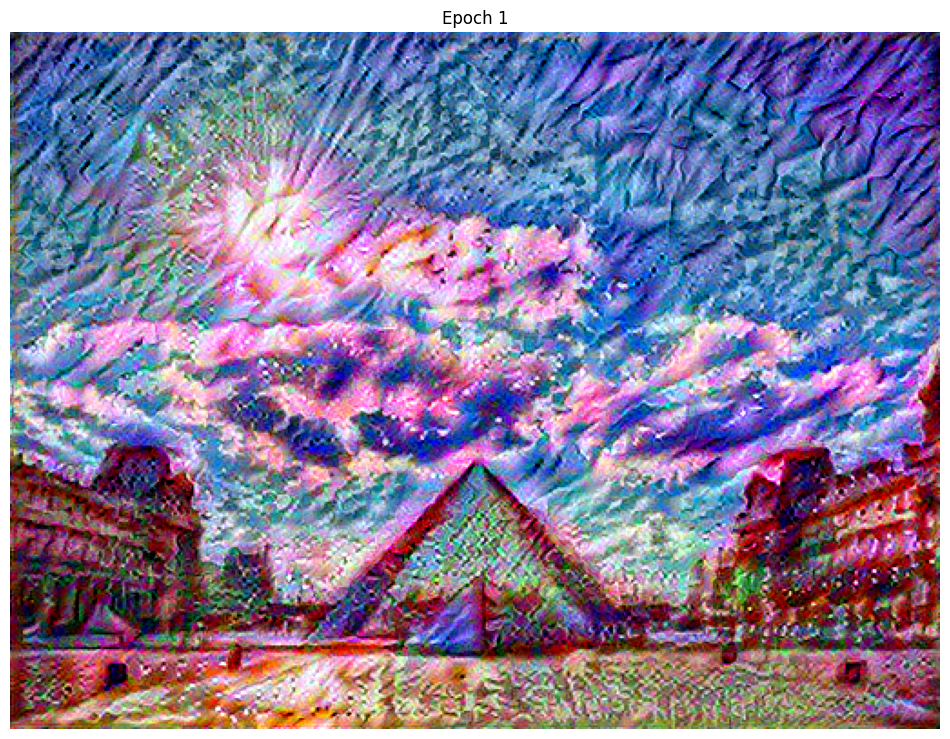

....................................................................................................

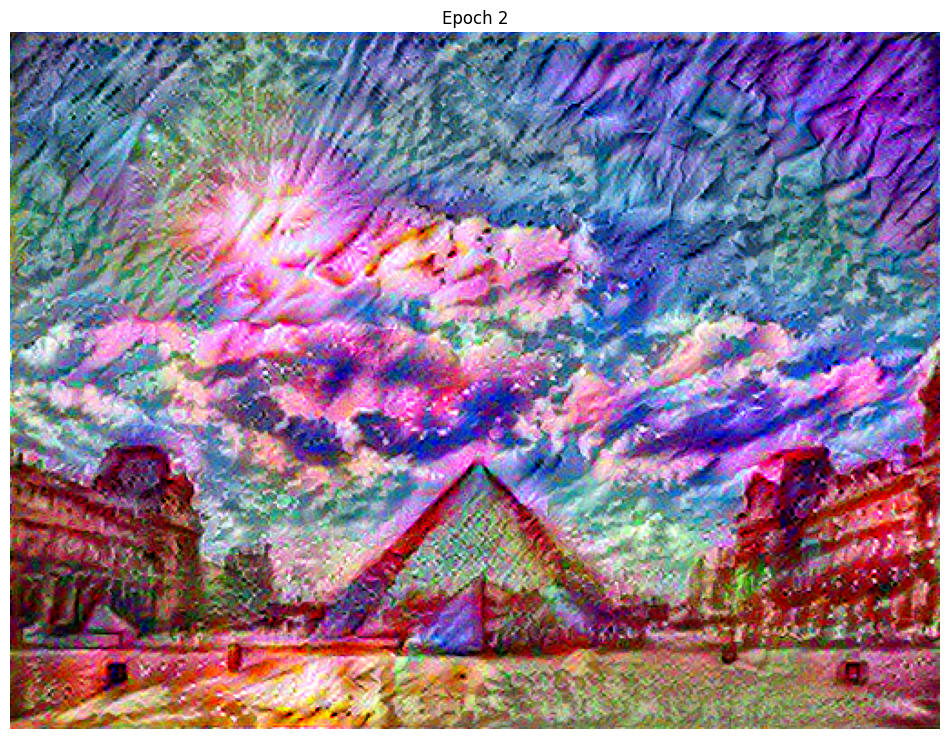

....................................................................................................

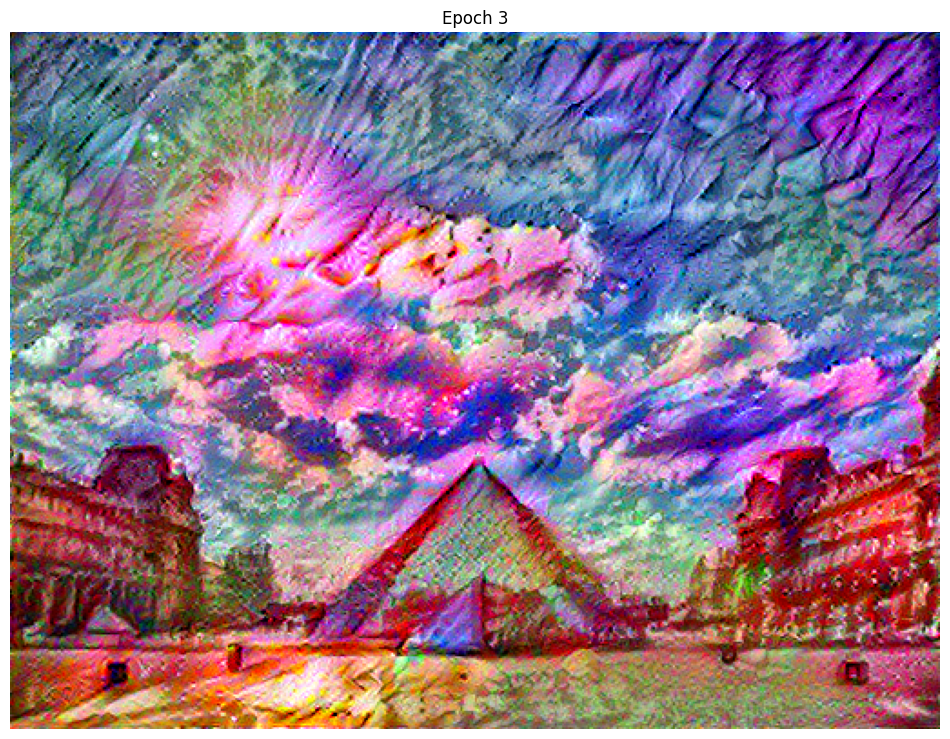

....................................................................................................

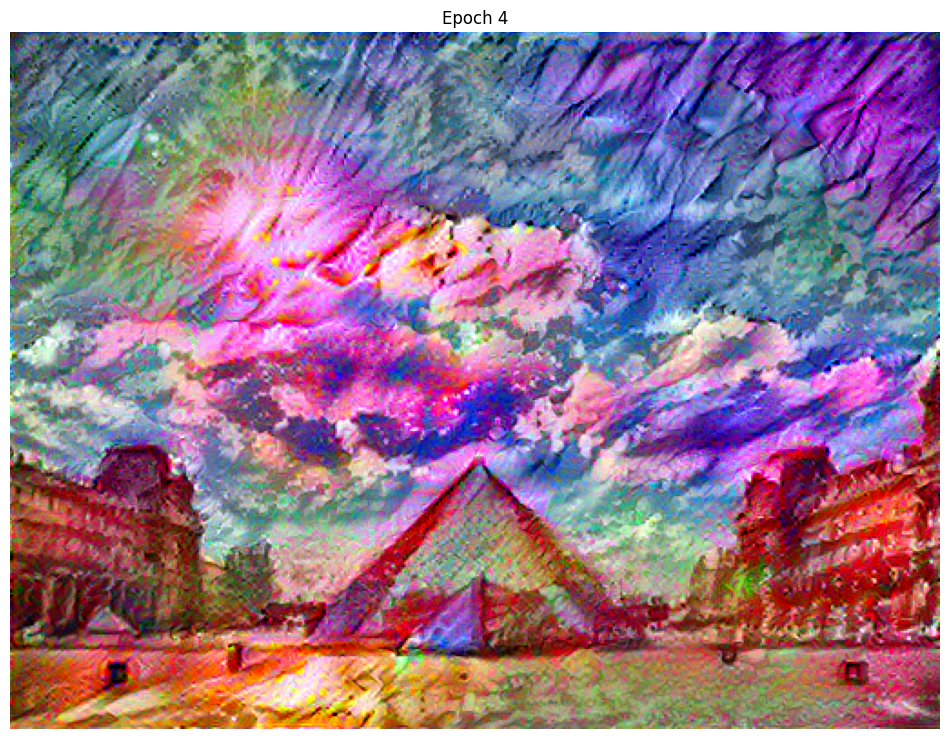

....................................................................................................

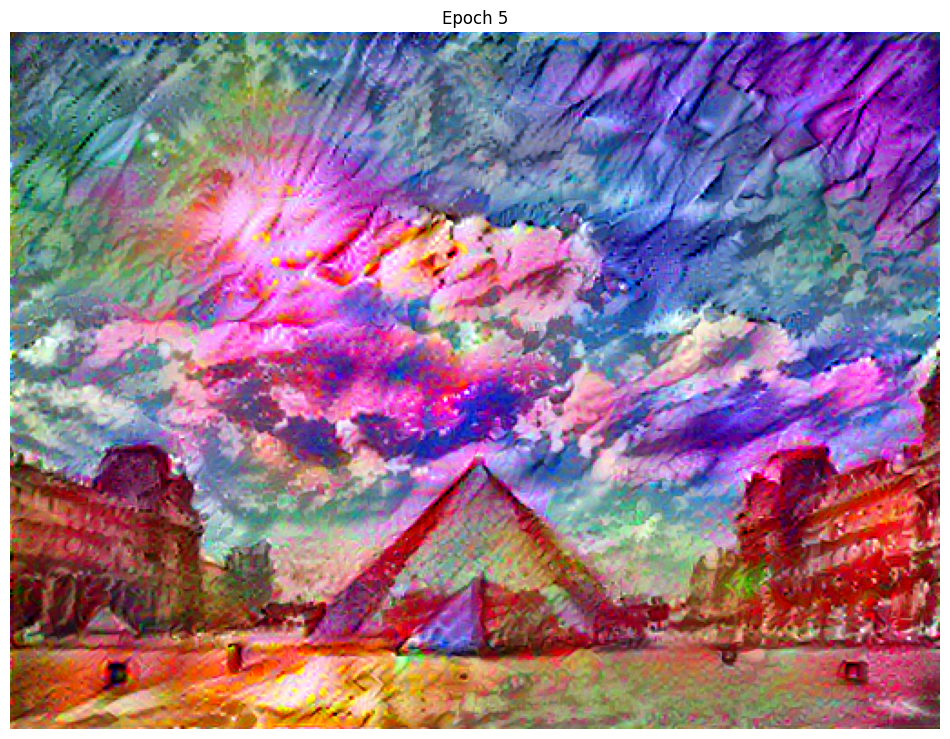

....................................................................................................

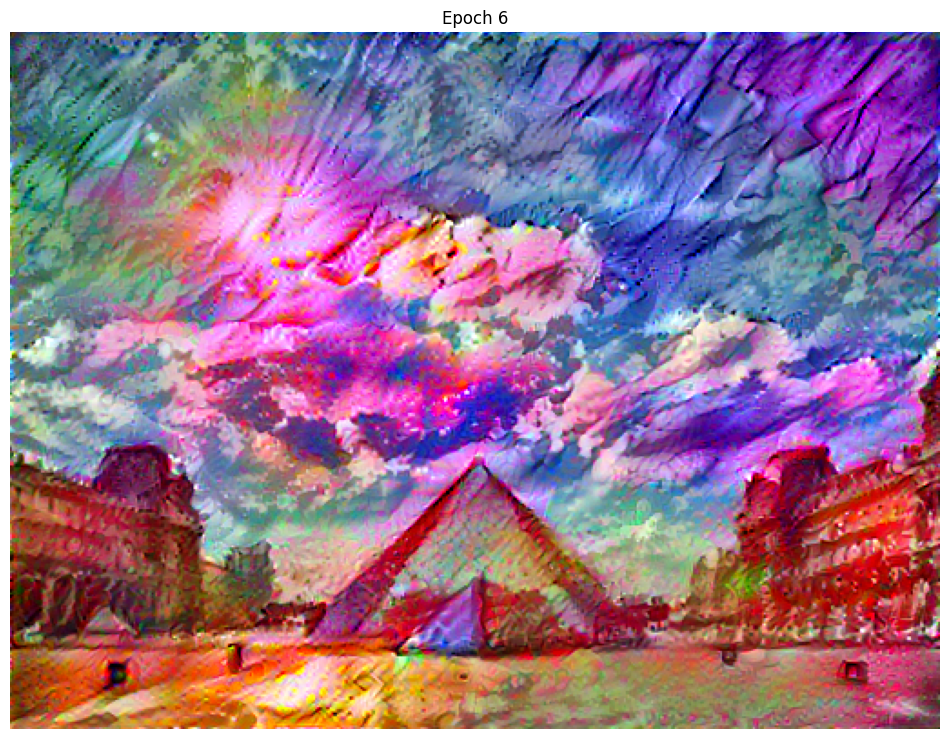

....................................................................................................

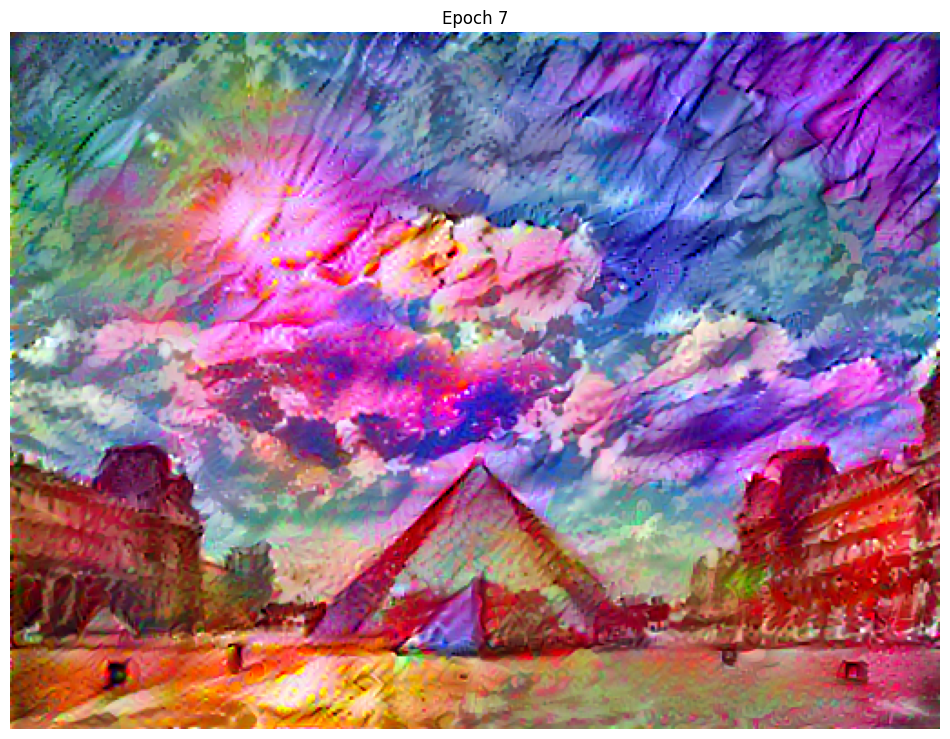

....................................................................................................

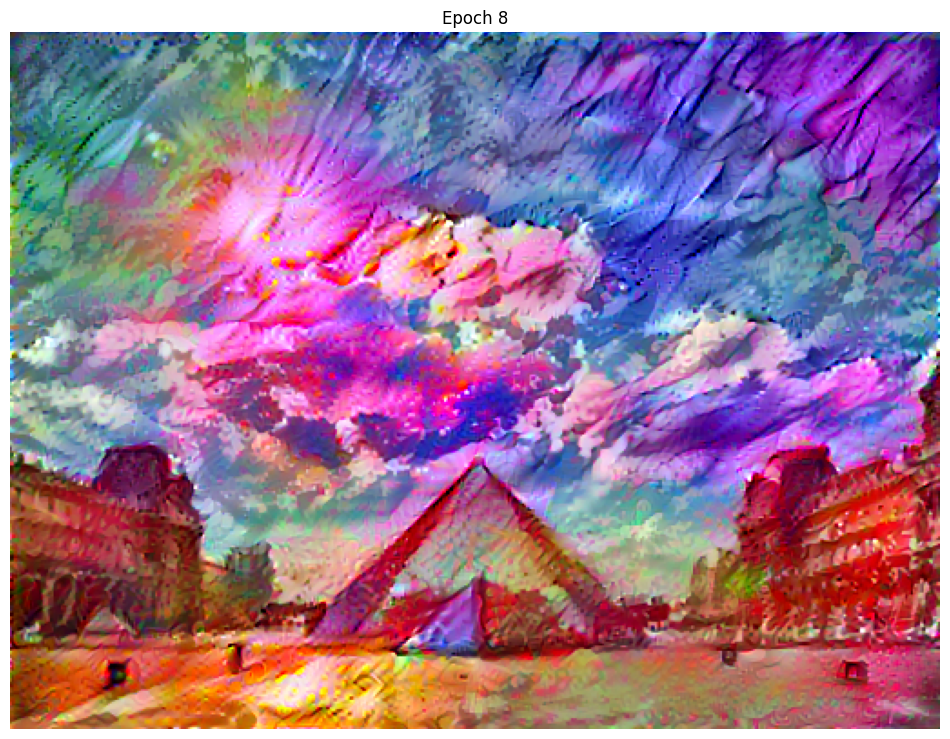

....................................................................................................

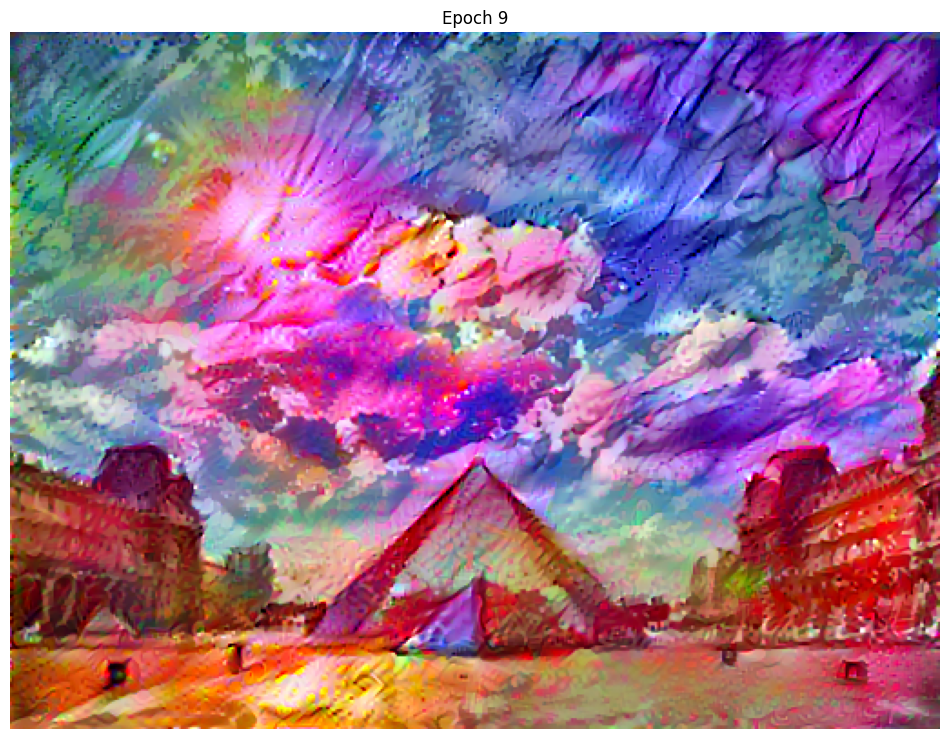

....................................................................................................

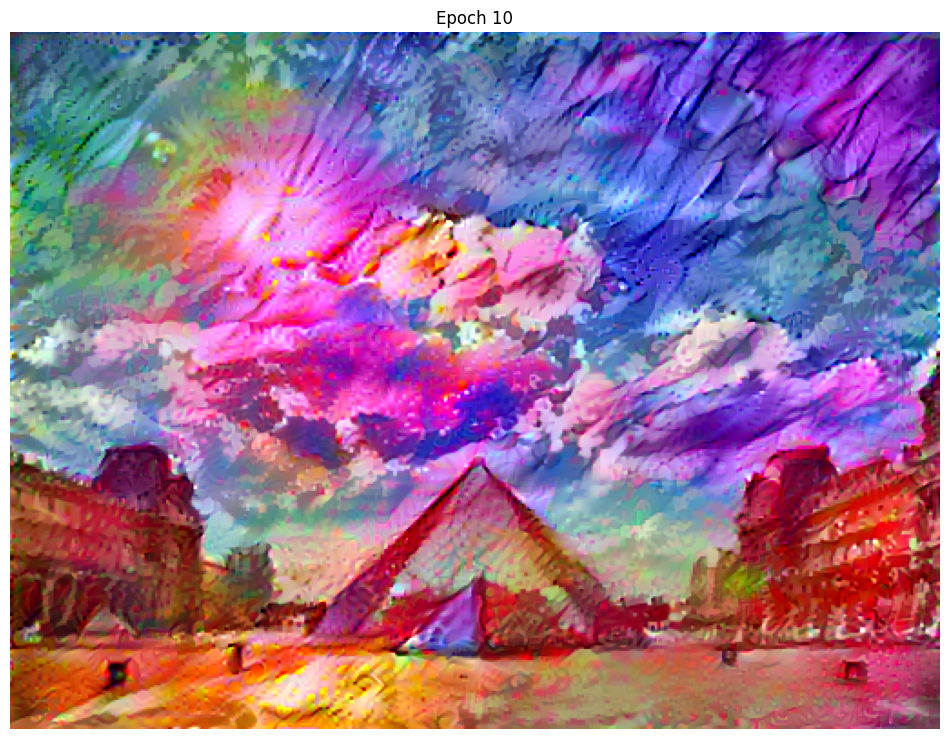

....................................................................................................

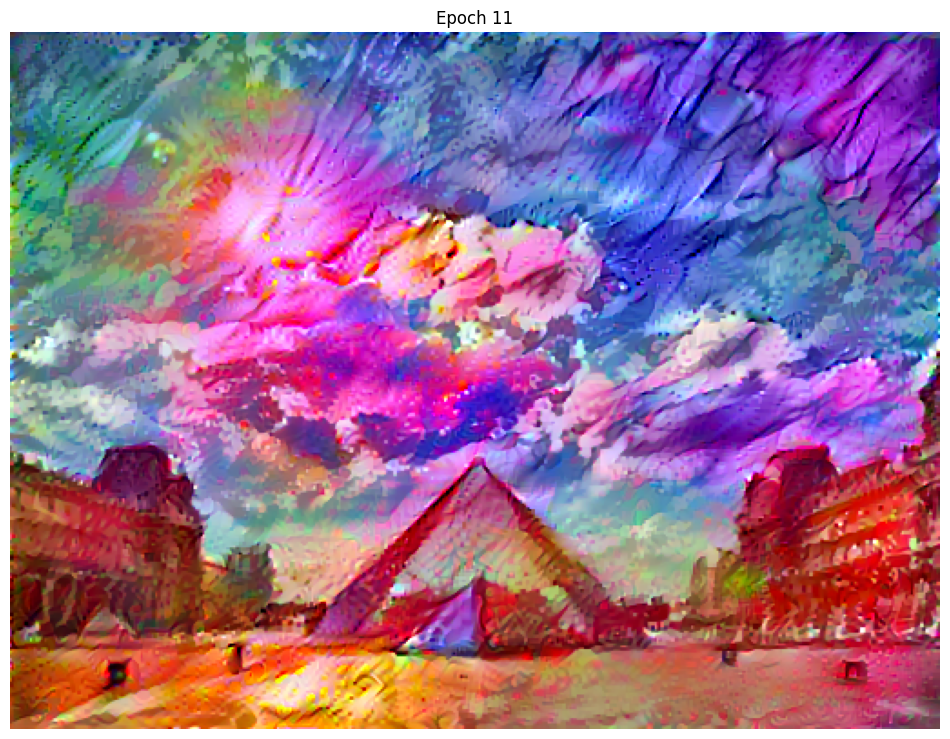

....................................................................................................

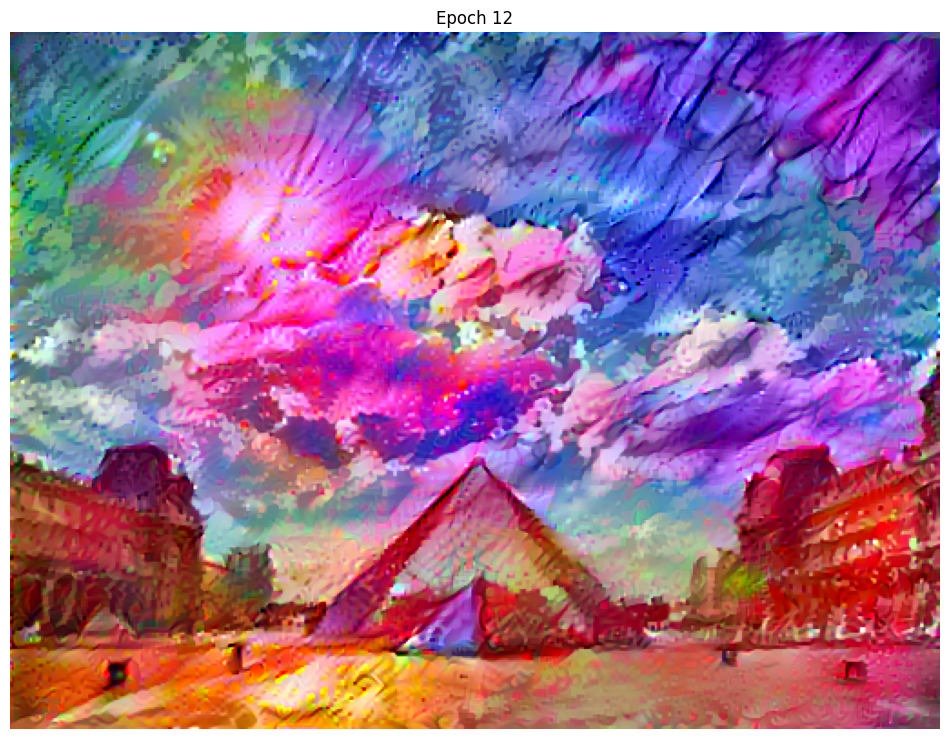

....................................................................................................

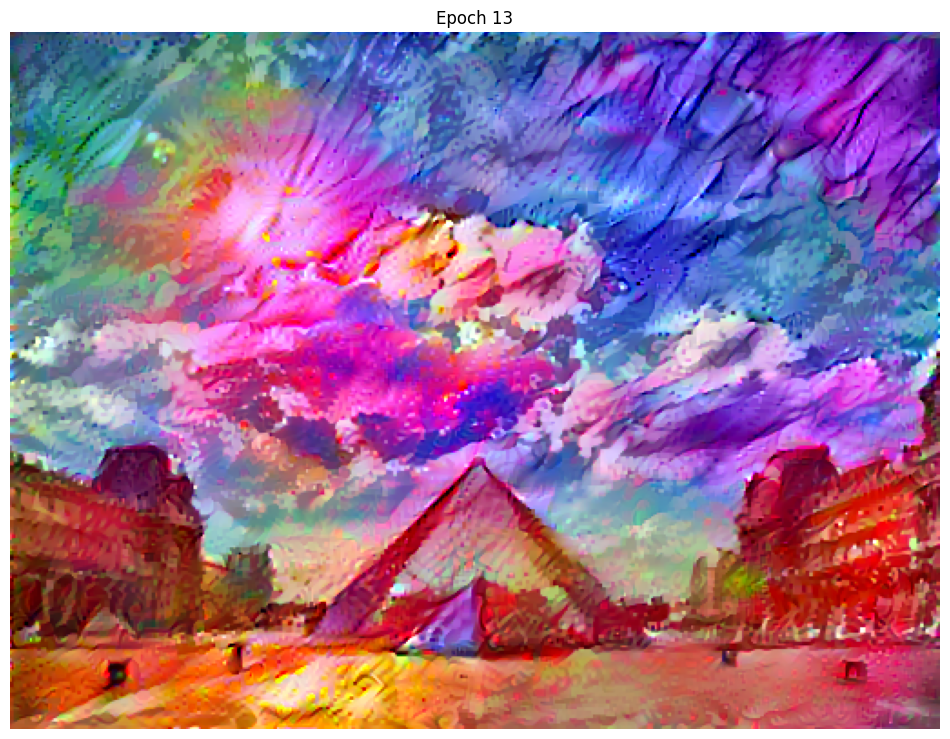

....................................................................................................

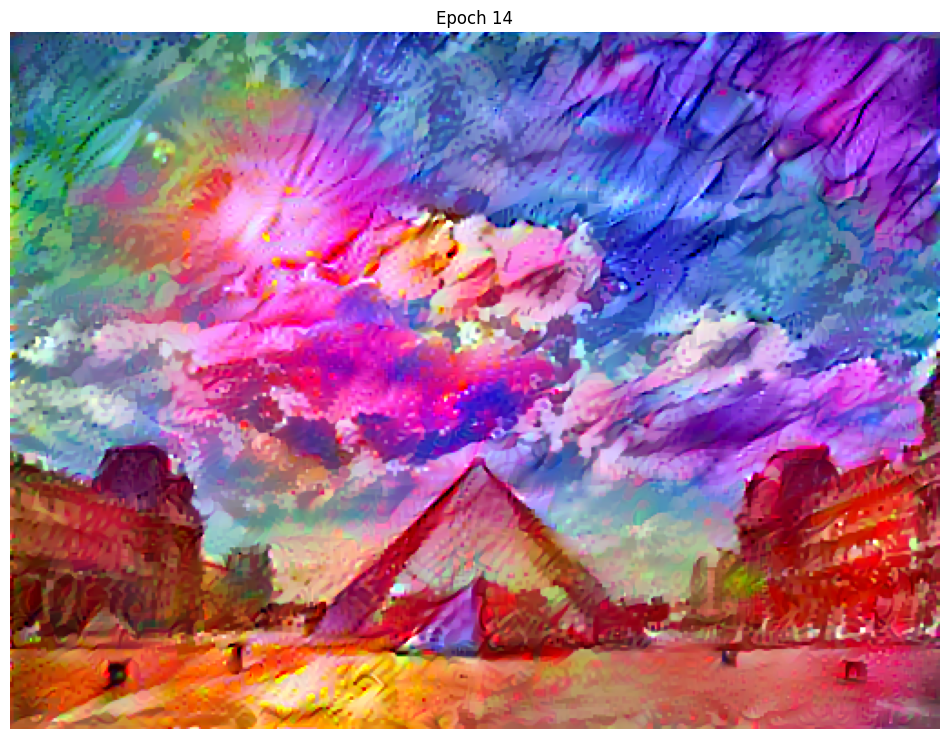

....................................................................................................

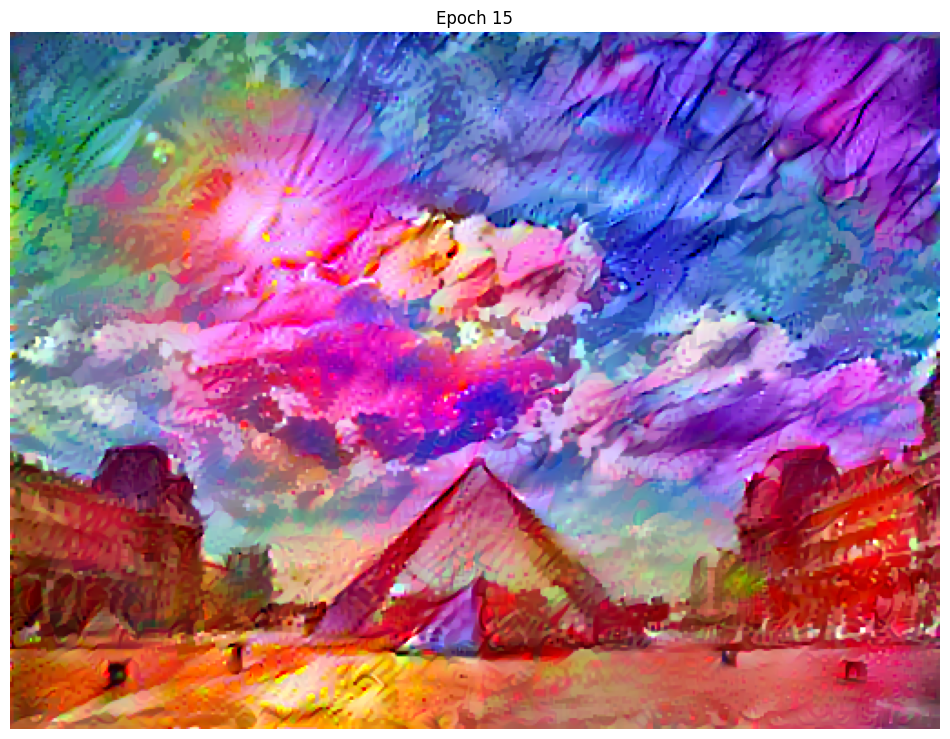

....................................................................................................

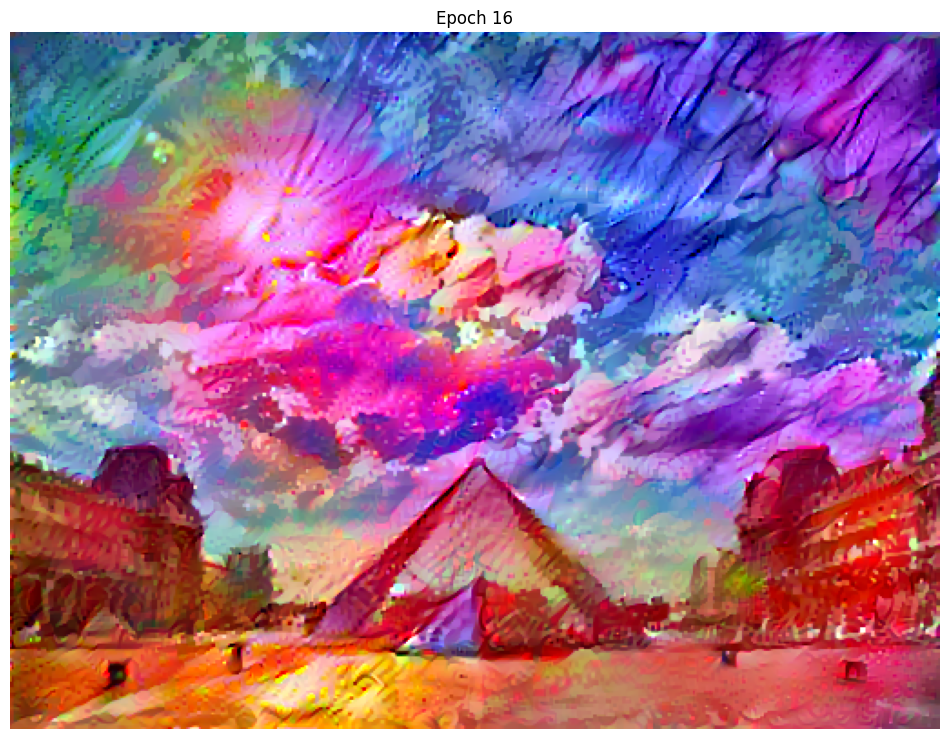

....................................................................................................

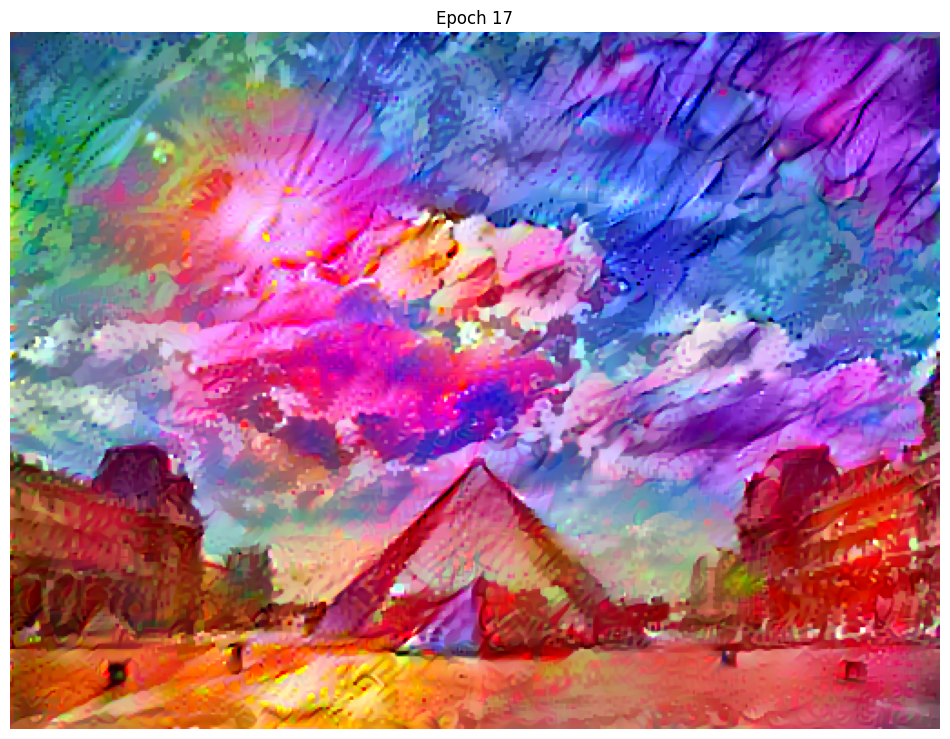

....................................................................................................

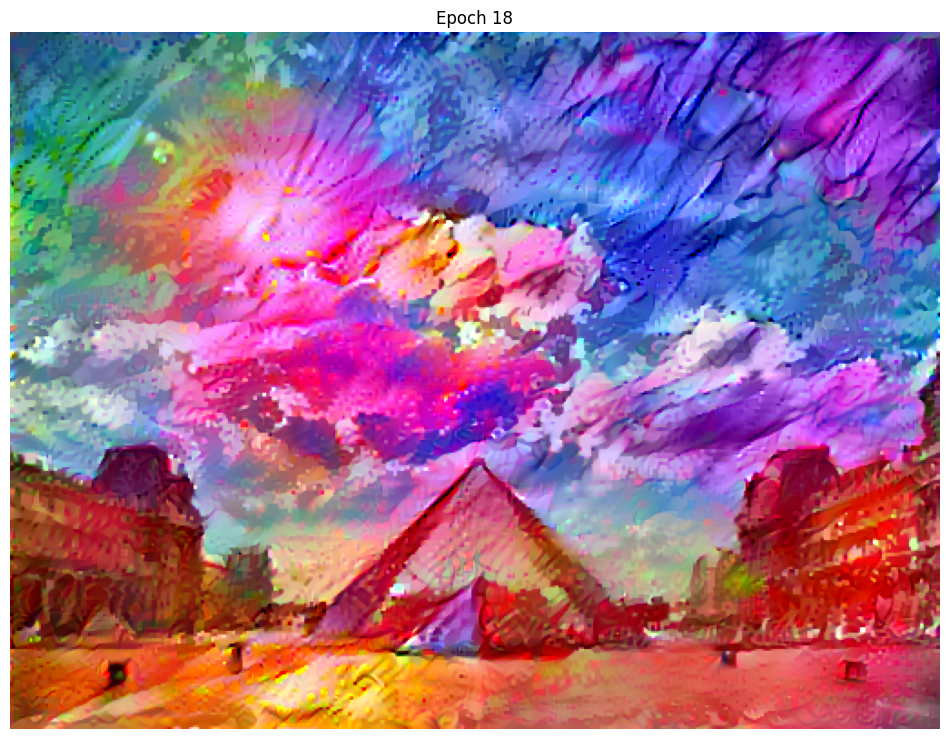

....................................................................................................

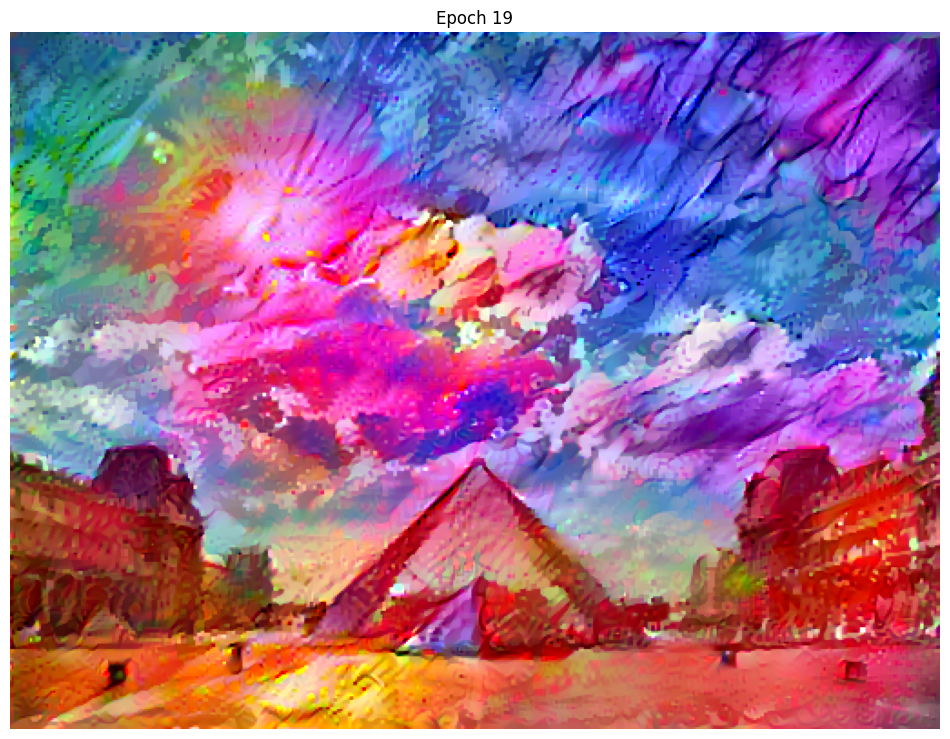

....................................................................................................

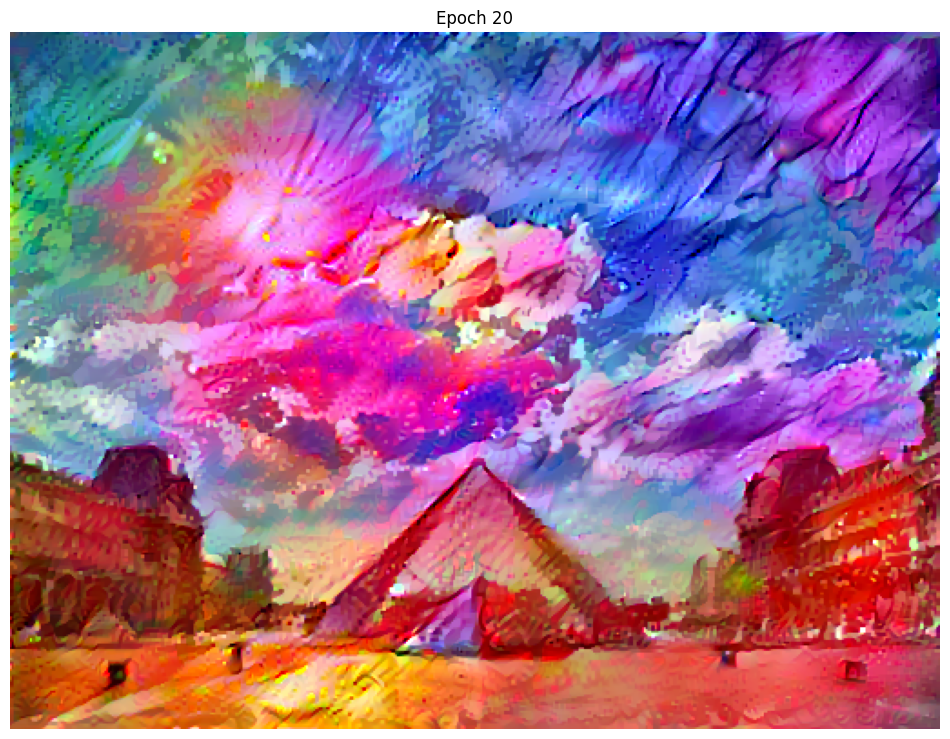

....................................................................................................

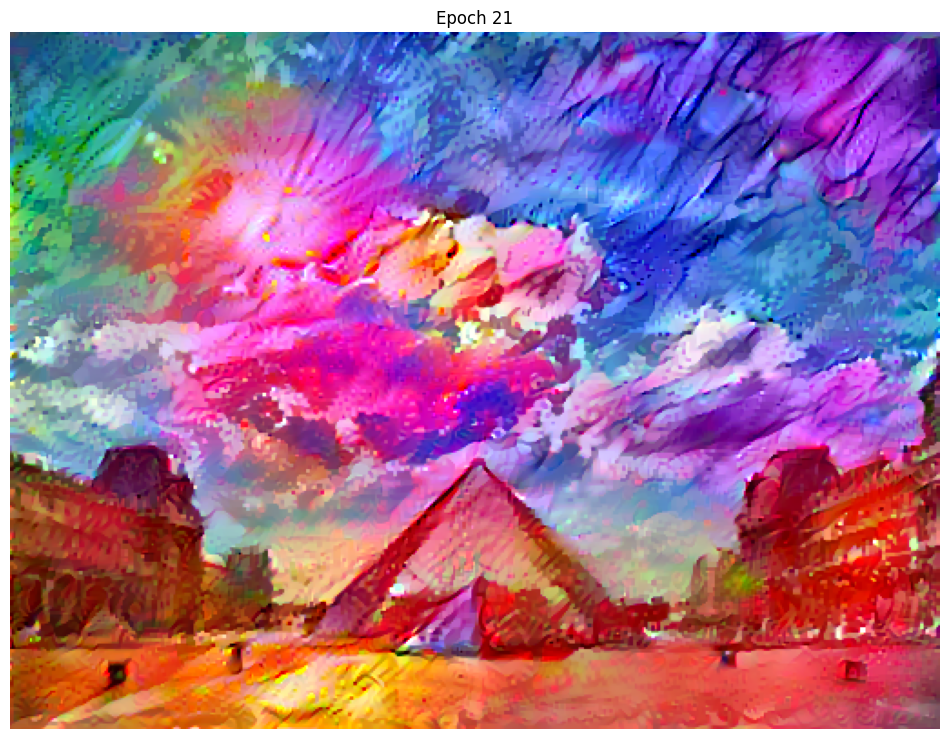

....................................................................................................

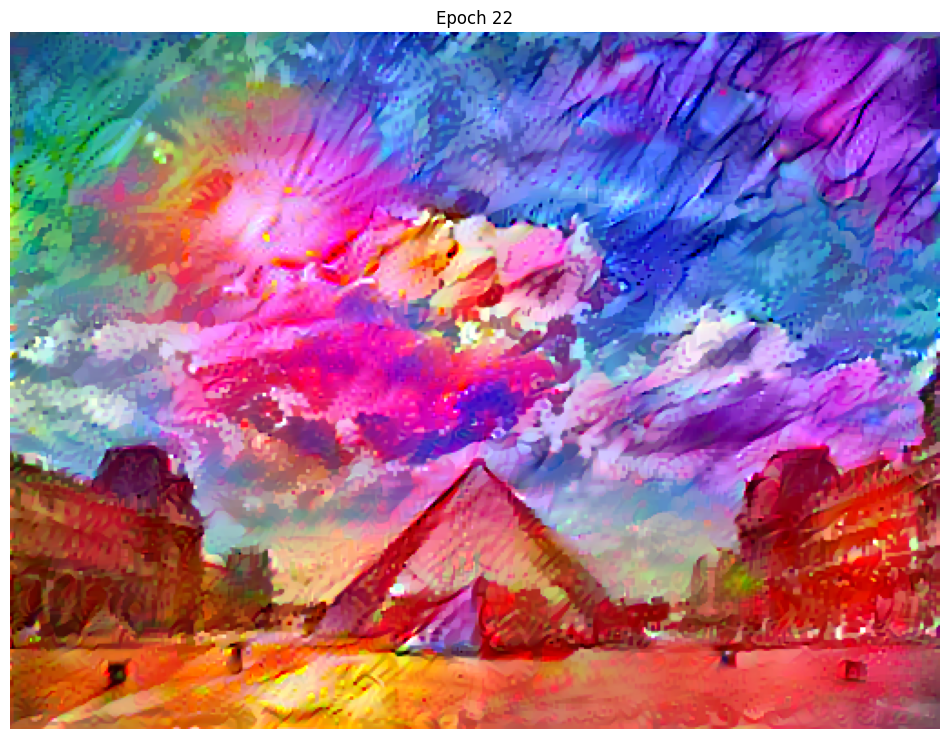

....................................................................................................

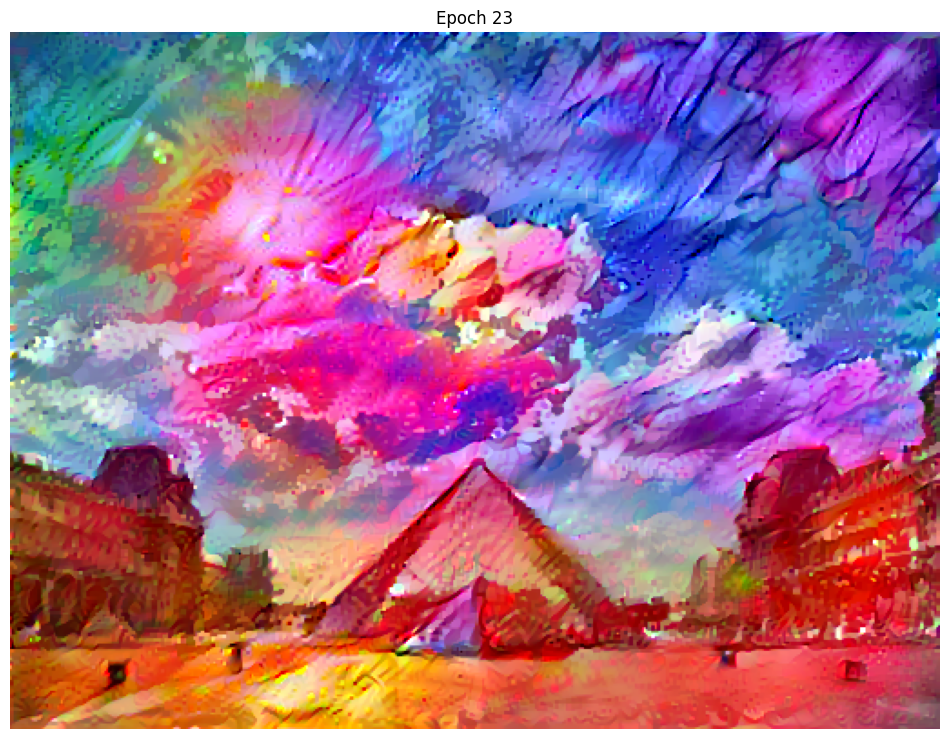

...............................

KeyboardInterrupt: 

In [41]:
# Run the optimization
epochs = 50  # Increased epochs
steps_per_epoch = 100

start = time.time()

for n in range(epochs):
    for m in range(steps_per_epoch):
        train_step(image)

        # Convert the stylized image back to tensor
        stylized_image = tensor_to_image(image)
        stylized_image_tensor = tf.convert_to_tensor(stylized_image, dtype=tf.float32)
        stylized_image_tensor = tf.image.resize(stylized_image_tensor, (512, 512))

        # Ensure the shape is correct: (512, 512, 3)
        stylized_image_tensor = tf.expand_dims(stylized_image_tensor, axis=0)  # Add batch dimension

        # Resize content_image to ensure it has the correct shape
        content_image_resized = tf.image.resize(content_image, (512, 512))  # Resize directly
        content_image_tensor = tf.convert_to_tensor(content_image_resized, dtype=tf.float32)

        # Use tf.squeeze to remove unnecessary dimensions
        content_image_tensor = tf.squeeze(content_image_tensor)  # Remove any extra dimensions

        # Ensure only one batch dimension is added
        content_image_tensor = tf.expand_dims(content_image_tensor, axis=0)  # Add batch dimension

        # Make sure shapes are correct before passing to GAN
        assert stylized_image_tensor.shape == (1, 512, 512, 3), f"Stylized Image Shape: {stylized_image_tensor.shape}"
        assert content_image_tensor.shape == (1, 512, 512, 3), f"Content Image Shape: {content_image_tensor.shape}"

        if m % 10 == 0:  # Apply GAN training every 10 steps
            gan_train_step(content_image_tensor, stylized_image_tensor)

        print(".", end='', flush=True)
    
    plt.imshow(tensor_to_image(image))
    plt.title(f"Epoch {n + 1}")
    plt.axis('off')
    plt.show()

end = time.time()
print(f"Total time: {end - start:.1f} seconds")

# Save the result
file_name = 'stylized-image.png'
tensor_to_image(image).save(file_name)

# Optionally download the image if running in Google Colab
try:
    from google.colab import files
    files.download(file_name)
except (ImportError, AttributeError):
    pass
